# Train a DCGAN to generate images from noise, Use EMNIST Dataset

## Checking Avilable GPU

In [1]:
!nvidia-smi

Wed May 10 12:47:06 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0  On |                  N/A |
|  0%   55C    P8    44W / 350W |    136MiB / 24576MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Importing requirements


In [2]:
# pytorch libs
import torch
from torch import nn
import torchvision

# matplot libs
import matplotlib.pyplot as plt

# numpy
import numpy as np

# torch metrics
try:
  import torchmetrics
except:
  !pip3 -q install torchmetrics
import torchmetrics
from torchmetrics.classification import Accuracy

try:
  import torchinfo
except:
  !pip3 -q install torchinfo
finally:
  from torchinfo import summary

import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

/home/planck/anaconda3/envs/bikash/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## device agnostic code

In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## Hyperparameters

In [4]:
# parameters from DC-GAN paper, https://arxiv.org/pdf/1511.06434.pdf, page 4

# Number of workers for dataloader
workers = 4

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
beta2 = 0.999

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

## Getting Dataset with pytorch

### Downloading the dataset

In [21]:
from torchvision import transforms

data_transforms_train = transforms.Compose([
    # transforms.RandomHorizontalFlip(p=1),
    # transforms.RandomRotation(degrees=(90*4)),
    transforms.Grayscale(num_output_channels=3),
    transforms.ToTensor(),
])

data_transforms_test = transforms.Compose([
    transforms.RandomHorizontalFlip(p=1),
    transforms.RandomRotation(degrees=(90*4)),
    transforms.Grayscale(num_output_channels=3),
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.5071, 0.4867, 0.4408], std=[0.2675, 0.2565, 0.2761]),
])

train_dataset = torchvision.datasets.EMNIST(
    root='./data',
    split='digits',
    train=True,
    download=True,
    transform=data_transforms_train,
)

test_dataset = torchvision.datasets.EMNIST(
    root='./data',
    split='digits',
    train=False,
    download=True,
    transform=data_transforms_test,
)
train_dataset, test_dataset

(Dataset EMNIST
     Number of datapoints: 240000
     Root location: ./data
     Split: Train
     StandardTransform
 Transform: Compose(
                Grayscale(num_output_channels=3)
                ToTensor()
            ),
 Dataset EMNIST
     Number of datapoints: 40000
     Root location: ./data
     Split: Test
     StandardTransform
 Transform: Compose(
                RandomHorizontalFlip(p=1)
                RandomRotation(degrees=[-360.0, 360.0], interpolation=nearest, expand=False, fill=0)
                Grayscale(num_output_channels=3)
                ToTensor()
            ))

### Vis. dataset (train dataset)

In [22]:
# plt.imshow(train_dataset[5][0].permute(1,2,0))
# plt.title(labels_map[train_dataset[5][1]])

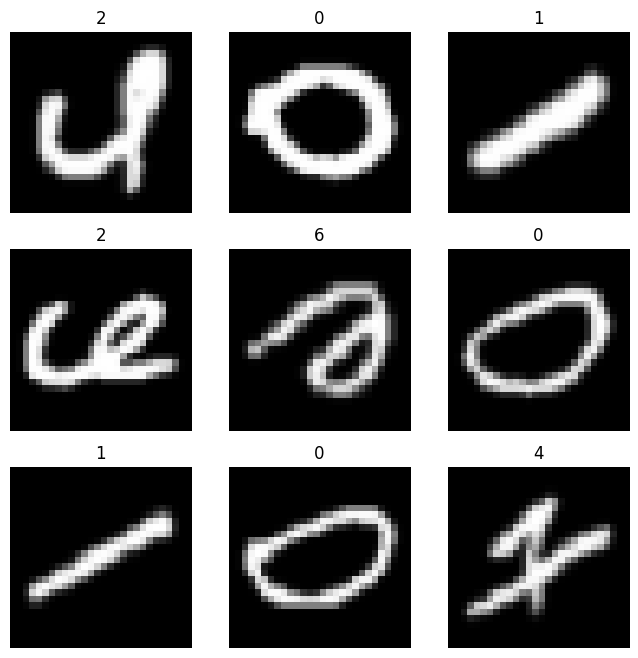

In [23]:
# randomly ploting image samples from the grayscale dataset
classes = train_dataset.classes
labels_map = {classes[i]:i for i in range(len(classes))}  # getting class -> index map
labels_map = dict(map(reversed, labels_map.items()))  # inverting dict
# print(labels_map)

figure = plt.figure(figsize=(8, 8))  # fixing plotsize
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    sample_idx = torch.randint(
        len(train_dataset), size=(1,)
    )  # randomely selecting one image sample from the image index
    img, label = train_dataset[sample_idx.item()]  # getting image and label of selected index
    # sub plot code
    figure.add_subplot(rows, cols, i)
    plt.title(labels_map[label])
    plt.axis("off")
    if len(img.shape) == 3:
        plt.imshow(
            img.permute(1, 2, 0)
        )  # NOTE:- Color map is gray because we're converting imgae to grayscale / changing channel to HWC for color image
    else:
        plt.imshow(
            img,
            cmap='gray'
        )
    # sub plot code ends
plt.show()

### Converting dataset to dataloader

In [24]:
import os

# hyper parms. for dataloader
BATCH_SIZE = 128
NUM_WORKERS = int(os.cpu_count()//8) + 1  # no. of avilable cpu cores

# train dataloader
train_dataloader = torch.utils.data.DataLoader(
    dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS
)

# test dataloader
test_dataloader = torch.utils.data.DataLoader(
    dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS
)

print(f"Numbers of Batches in Train Dataloader: {len(train_dataloader)}")
print(f"Numbers of Batches in Test Dataloader: {len(test_dataloader)}")
# train_dataloader,test_dataloader

Numbers of Batches in Train Dataloader: 1875
Numbers of Batches in Test Dataloader: 313


## Model Defination

In [25]:
from resnet_arch import resnet56


def get_resnet():
    model = resnet56()
    model.linear = nn.Sequential(
        nn.Linear(64, 1),
        nn.Sigmoid()
    )
    return model

In [26]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [27]:
# class definition for discriminator from DCGAN paper, https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc, ngpu=0):
        super().__init__()
        self.ngpu = ngpu
        self.nz = nz
        self.ngf = ngf
        self.nc = nc

        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     nc, 4, 2, 1, bias=False),
            # nn.Tanh()
            nn.Sigmoid()
            # state size. (nc) x 64 x 64
        )
    
    def forward(self, input):
        return self.main(input)

In [28]:
# class definition for discriminator from DCGAN paper, https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class Discriminator(nn.Module):
    def __init__(self,nc,ndf,ngpu=0):
        super().__init__()
        self.main = get_resnet()

    def forward(self, input):
        return self.main(input)

## Model Objects

In [29]:
# Create the generator
netG = Generator(nc=nc,ngf=ngf,nz=nz,ngpu=ngpu).to(device)

# Handle multi-GPU if desired
if (device == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Sigmoid

In [30]:
# Create the Discriminator
netD = Discriminator(nc=nc,ndf=ndf,ngpu=ngpu).to(device)

# Handle multi-GPU if desired
if (device == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): ResNet(
    (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (shortcut): Sequential()
      )
      (1): BasicBlock(
        (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        

## loss function and optimizer

In [31]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = torch.optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

In [32]:
from tqdm.auto import tqdm
# Training function
# Lists to keep track of progress
def train(dataloader,netD,netG,optimizerD,optimizerG,criterion,device,num_epochs):
    img_list = []
    G_losses = []
    D_losses = []
    iters = 0

    print("Starting Training Loop...")
    # For each epoch
    for epoch in tqdm(range(num_epochs),desc="Epochs"):
        # For each batch in the dataloader
        for i, data in tqdm(enumerate(dataloader),desc="Dataloader",leave=True,total=len(dataloader)):

            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Train with all-real batch
            netD.zero_grad()
            # Format batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            output = netD(real_cpu).view(-1)
            # Calculate loss on all-real batch
            errD_real = criterion(output, label)
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()

            ## Train with all-fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            # Generate fake image batch with G
            fake = netG(noise)
            label.fill_(fake_label)
            # Classify all fake batch with D
            output = netD(fake.detach()).view(-1)
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label)
            # Calculate the gradients for this batch, accumulated (summed) with previous gradients
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(fake).view(-1)
            # Calculate G's loss based on this output
            errG = criterion(output, label)
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Update G
            optimizerG.step()

            # Output training stats
            if i % 250 == 0:
                print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (epoch, num_epochs, i, len(dataloader),
                        errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
                with torch.inference_mode():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            iters += 1
    return img_list,G_losses,D_losses

In [33]:
img_list,G_losses,D_losses = train(train_dataloader,netD,netG,optimizerD,optimizerG,criterion,device,num_epochs)

Starting Training Loop...


Epochs:   0%|          | 0/10 [00:00<?, ?it/s]

[0/10][0/1875]	Loss_D: 2.4757	Loss_G: 0.2120	D(x): 0.9059	D(G(z)): 0.9062 / 0.8090


[0/10][250/1875]	Loss_D: 0.0031	Loss_G: 6.0567	D(x): 0.9994	D(G(z)): 0.0025 / 0.0024


[0/10][500/1875]	Loss_D: 0.0071	Loss_G: 5.4336	D(x): 0.9978	D(G(z)): 0.0049 / 0.0044


[0/10][750/1875]	Loss_D: 0.0024	Loss_G: 6.3593	D(x): 0.9994	D(G(z)): 0.0018 / 0.0017


[0/10][1000/1875]	Loss_D: 0.0012	Loss_G: 7.1015	D(x): 0.9997	D(G(z)): 0.0008 / 0.0008


[0/10][1250/1875]	Loss_D: 0.0008	Loss_G: 7.5051	D(x): 0.9998	D(G(z)): 0.0006 / 0.0006


[0/10][1500/1875]	Loss_D: 0.0006	Loss_G: 7.8083	D(x): 0.9998	D(G(z)): 0.0004 / 0.0004


[0/10][1750/1875]	Loss_D: 0.0004	Loss_G: 8.1749	D(x): 0.9999	D(G(z)): 0.0003 / 0.0003


Epochs:  10%|█         | 1/10 [06:01<54:15, 361.70s/it]

[1/10][0/1875]	Loss_D: 0.0004	Loss_G: 8.2638	D(x): 0.9999	D(G(z)): 0.0003 / 0.0003


[1/10][250/1875]	Loss_D: 0.0003	Loss_G: 8.4952	D(x): 0.9999	D(G(z)): 0.0002 / 0.0002


[1/10][500/1875]	Loss_D: 0.0002	Loss_G: 8.7365	D(x): 0.9999	D(G(z)): 0.0002 / 0.0002


[1/10][750/1875]	Loss_D: 0.0002	Loss_G: 8.9189	D(x): 0.9999	D(G(z)): 0.0001 / 0.0001


Dataloader:  40%|████      | 752/1875 [02:24<03:37,  5.16it/s]

[1/10][1000/1875]	Loss_D: 0.0002	Loss_G: 9.0707	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


[1/10][1250/1875]	Loss_D: 0.0001	Loss_G: 9.2757	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


[1/10][1500/1875]	Loss_D: 0.0001	Loss_G: 9.4079	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


[1/10][1750/1875]	Loss_D: 0.0001	Loss_G: 9.5743	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


Epochs:  20%|██        | 2/10 [12:02<48:10, 361.35s/it]

[2/10][0/1875]	Loss_D: 0.0001	Loss_G: 9.6598	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


[2/10][250/1875]	Loss_D: 0.0001	Loss_G: 9.8169	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001


[2/10][500/1875]	Loss_D: 0.0001	Loss_G: 9.9701	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[2/10][750/1875]	Loss_D: 0.0001	Loss_G: 10.1040	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[2/10][1000/1875]	Loss_D: 0.0001	Loss_G: 10.2348	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[2/10][1250/1875]	Loss_D: 0.0000	Loss_G: 10.3950	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[2/10][1500/1875]	Loss_D: 0.0000	Loss_G: 10.5374	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[2/10][1750/1875]	Loss_D: 0.0000	Loss_G: 10.6594	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  30%|███       | 3/10 [18:06<42:15, 362.25s/it]

[3/10][0/1875]	Loss_D: 0.0000	Loss_G: 10.7355	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][250/1875]	Loss_D: 0.0000	Loss_G: 10.8505	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][500/1875]	Loss_D: 0.0000	Loss_G: 10.9403	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][750/1875]	Loss_D: 0.0000	Loss_G: 11.0183	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][1000/1875]	Loss_D: 0.0000	Loss_G: 11.0991	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][1250/1875]	Loss_D: 0.0000	Loss_G: 11.2362	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][1500/1875]	Loss_D: 0.0000	Loss_G: 11.3523	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[3/10][1750/1875]	Loss_D: 0.0000	Loss_G: 11.5161	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  40%|████      | 4/10 [24:08<36:14, 362.49s/it]

[4/10][0/1875]	Loss_D: 0.0000	Loss_G: 11.6020	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][250/1875]	Loss_D: 0.0000	Loss_G: 11.7624	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][500/1875]	Loss_D: 0.0000	Loss_G: 11.9156	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][750/1875]	Loss_D: 0.0000	Loss_G: 12.0600	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][1000/1875]	Loss_D: 0.0000	Loss_G: 12.1970	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][1250/1875]	Loss_D: 0.0000	Loss_G: 12.3199	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][1500/1875]	Loss_D: 0.0000	Loss_G: 12.4453	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[4/10][1750/1875]	Loss_D: 0.0000	Loss_G: 12.5706	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  50%|█████     | 5/10 [30:12<30:13, 362.75s/it]

[5/10][0/1875]	Loss_D: 0.0000	Loss_G: 12.6320	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][250/1875]	Loss_D: 0.0000	Loss_G: 12.7613	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][500/1875]	Loss_D: 0.0000	Loss_G: 12.8859	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][750/1875]	Loss_D: 0.0000	Loss_G: 13.0088	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][1000/1875]	Loss_D: 0.0000	Loss_G: 13.1271	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][1250/1875]	Loss_D: 0.0000	Loss_G: 13.2546	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][1500/1875]	Loss_D: 0.0000	Loss_G: 13.3772	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[5/10][1750/1875]	Loss_D: 0.0000	Loss_G: 13.5007	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  60%|██████    | 6/10 [36:13<24:09, 362.41s/it]

[6/10][0/1875]	Loss_D: 0.0000	Loss_G: 13.5574	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[6/10][250/1875]	Loss_D: 0.0000	Loss_G: 13.6872	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[6/10][500/1875]	Loss_D: 0.0000	Loss_G: 13.8028	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[6/10][750/1875]	Loss_D: 0.0000	Loss_G: 13.9247	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[6/10][1000/1875]	Loss_D: 0.0000	Loss_G: 14.0601	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[6/10][1250/1875]	Loss_D: 0.0000	Loss_G: 14.1840	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000



Dataloader:  80%|████████  | 1502/1875 [04:50<01:12,  5.13it/s]

[6/10][1500/1875]	Loss_D: 0.0000	Loss_G: 14.3156	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000



Dataloader:  93%|█████████▎| 1752/1875 [05:38<00:23,  5.14it/s]

[6/10][1750/1875]	Loss_D: 0.0000	Loss_G: 14.4438	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  70%|███████   | 7/10 [42:16<18:07, 362.60s/it]

[7/10][0/1875]	Loss_D: 0.0000	Loss_G: 14.5013	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][250/1875]	Loss_D: 0.0000	Loss_G: 14.6244	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][500/1875]	Loss_D: 0.0000	Loss_G: 14.7543	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][750/1875]	Loss_D: 0.0000	Loss_G: 14.8990	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][1000/1875]	Loss_D: 0.0000	Loss_G: 15.0160	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][1250/1875]	Loss_D: 0.0000	Loss_G: 15.1400	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][1500/1875]	Loss_D: 0.0000	Loss_G: 15.2614	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[7/10][1750/1875]	Loss_D: 0.0000	Loss_G: 15.3756	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  80%|████████  | 8/10 [48:18<12:04, 362.42s/it]

[8/10][0/1875]	Loss_D: 0.0000	Loss_G: 15.4349	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[8/10][250/1875]	Loss_D: 0.0000	Loss_G: 15.5697	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[8/10][500/1875]	Loss_D: 0.0000	Loss_G: 15.7162	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[8/10][750/1875]	Loss_D: 0.0000	Loss_G: 15.8452	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[8/10][1000/1875]	Loss_D: 0.0000	Loss_G: 15.9862	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Dataloader:  53%|█████▎    | 1002/1875 [03:13<02:50,  5.12it/s]

[8/10][1250/1875]	Loss_D: 0.0000	Loss_G: 16.1114	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000



Dataloader:  80%|████████  | 1502/1875 [04:50<01:12,  5.15it/s]

[8/10][1500/1875]	Loss_D: 0.0000	Loss_G: 16.2504	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[8/10][1750/1875]	Loss_D: 0.0000	Loss_G: 16.3883	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs:  90%|█████████ | 9/10 [54:21<06:02, 362.51s/it]

[9/10][0/1875]	Loss_D: 0.0000	Loss_G: 16.4536	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][250/1875]	Loss_D: 0.0000	Loss_G: 16.5901	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][500/1875]	Loss_D: 0.0000	Loss_G: 16.7193	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][750/1875]	Loss_D: 0.0000	Loss_G: 16.8535	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][1000/1875]	Loss_D: 0.0000	Loss_G: 16.9771	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][1250/1875]	Loss_D: 0.0000	Loss_G: 17.1110	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][1500/1875]	Loss_D: 0.0000	Loss_G: 17.2394	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


[9/10][1750/1875]	Loss_D: 0.0000	Loss_G: 17.3628	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


Epochs: 100%|██████████| 10/10 [1:00:24<00:00, 362.47s/it]


In [34]:
# saving models
torch.save(netG.state_dict(), 'generator.pth')
torch.save(netD.state_dict(), 'discriminator.pth')

# saving optimizers   
torch.save(optimizerG.state_dict(), 'optimizerG.pth')
torch.save(optimizerD.state_dict(), 'optimizerD.pth')

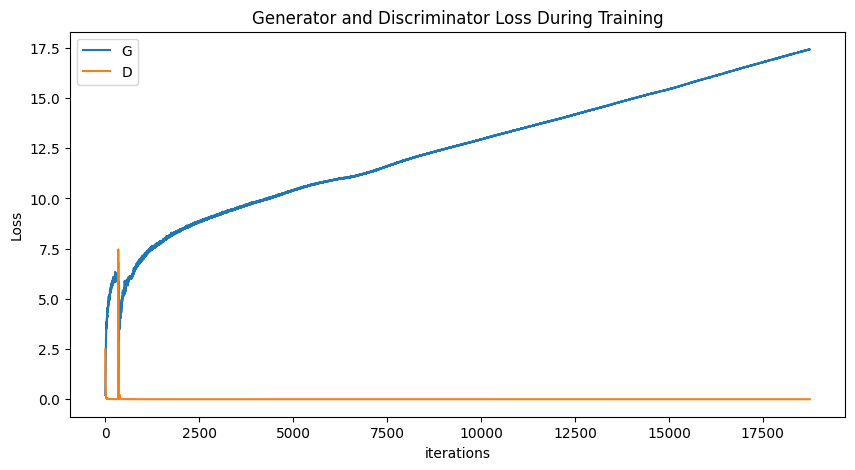

In [35]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 22063828 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


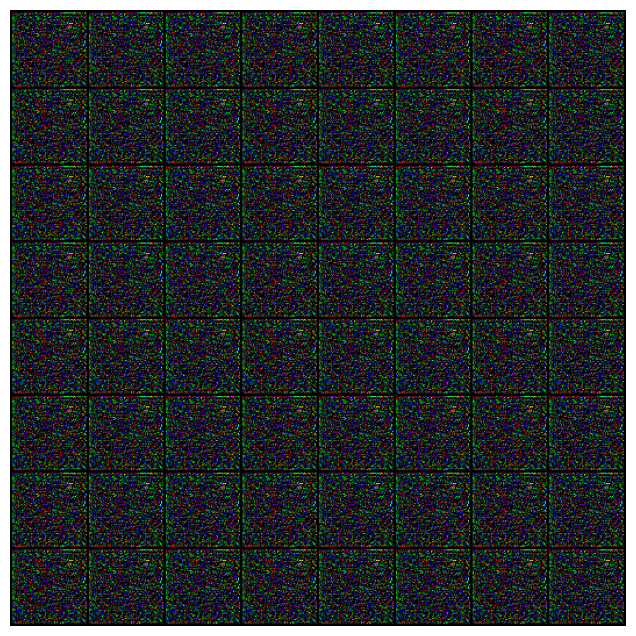

In [36]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())